In [10]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
import os
from DiceTowerVision import *
import csv

file_template = "Images\\Templates\\DDR# (A) (FV#).jpg"
background_file_template = "Images\\Calibration\\background (*).jpg"
background_images_RGB = get_mactching_images_RGB(background_file_template,log_level=LOG_LEVEL_INFO)
roi_mask = get_roi_mask_from_bg_images(background_images_RGB,range=(0,10), filter=25, dilation=5, log_level=LOG_LEVEL_INFO)
# camera_matrix = get_intrinsic_camera_matrix(2592,1944,8.2,0.00141)

#dieset = DieSet.create_common_die_set_from_images(file_template,names=[4,6,8,10,12,20,100],roi_mask=roi_mask,log_level=LOG_LEVEL_WARN)
dieset = DieSet.create_common_die_set_from_images(file_template,names=[20],roi_mask=roi_mask,log_level=LOG_LEVEL_WARN)
roll_template = "Images\\Rolls\\d4d6d8d10d12d20d100 (R#).jpg"
#roll_template = "Images\\Rolls\\2d20 (R#).jpg"
#roll_template = "Images\\Rolls\\stack d8 (R#).jpg"
#roll_template = "Images\\Rolls\\4d4 (R#).jpg"
sample_template = "Images\\Samples\\DDR#\\Group DDR#-FV# (*).jpg"

In [ ]:
roll=4
roll_file = roll_template.replace("R#",str(roll))
image_roll_RGB = cv.cvtColor(cv.imread(roll_file),cv.COLOR_BGR2RGB)
plt.imshow(image_roll_RGB)
plt.title("Test Image of Sample Roll")
plt.show()

for diename in dieset.dies.keys():
    die = dieset.dies[diename]
    result = die.get_best_point_from_image(image_roll_RGB,roi_mask,log_level=LOG_LEVEL_VERBOSE)

In [ ]:
roll=4
name = 4
roll_file = roll_template.replace("R#",str(roll))
image_roll_RGB = cv.cvtColor(cv.imread(roll_file),cv.COLOR_BGR2RGB)

die = dieset.dies[str(name)]
result = die.get_best_point_from_image(image_roll_RGB,roi_mask,log_level=LOG_LEVEL_DEBUG)
sample = die.get_sample_at_point_from_image(image_roll_RGB,result.point,log_level=LOG_LEVEL_VERBOSE)
results = die.compare_to_sample(sample, log_level=LOG_LEVEL_VERBOSE)
die.view_match_results(results)


Finished search because best die match, 20, has low confidence: 12.836266%


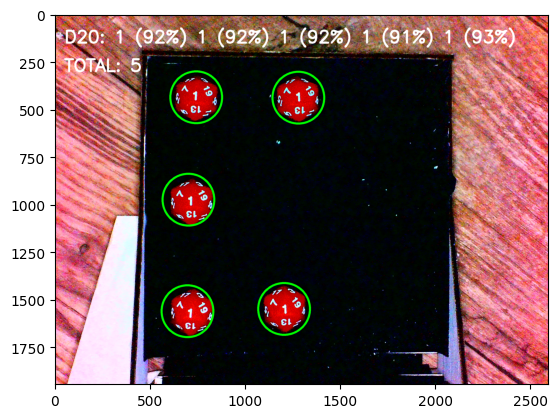

Finished search because best die match, 20, has low confidence: 26.234138%


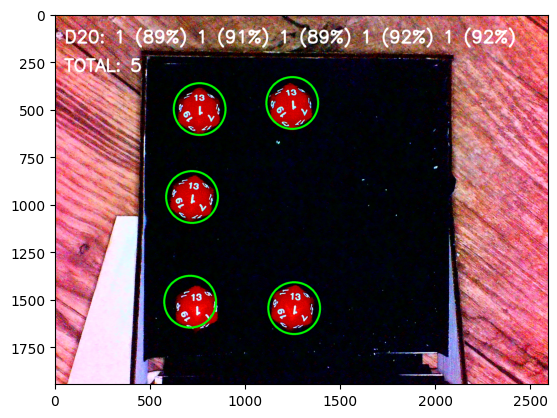

Finished search because best die match, 20, has low confidence: 19.159830%


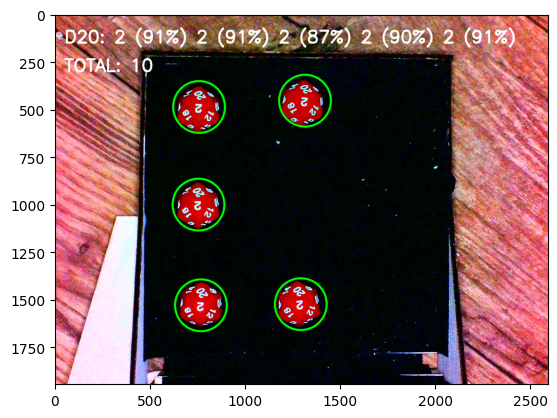

Finished search because best die match, 20, has low confidence: 17.692989%


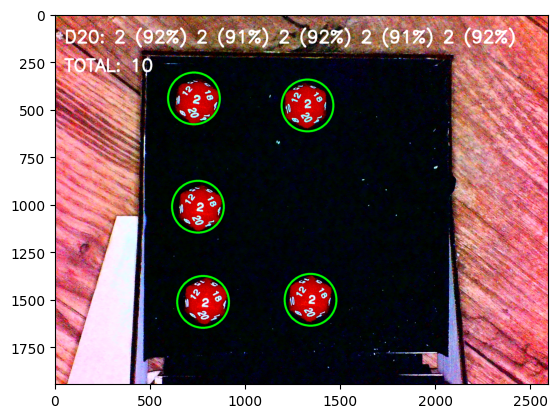

Finished search because best die match, 20, has low confidence: 20.838892%


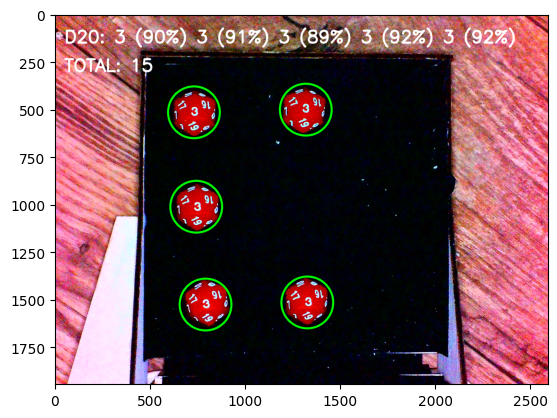

Finished search because best die match, 20, has low confidence: 14.701569%


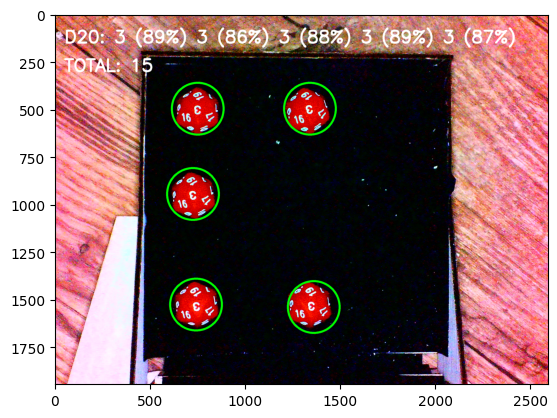

Finished search because best die match, 20, has low confidence: 19.555402%


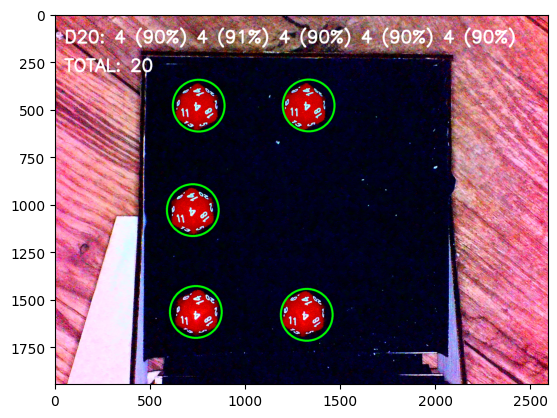

Finished search because best die match, 20, has low confidence: 21.580976%


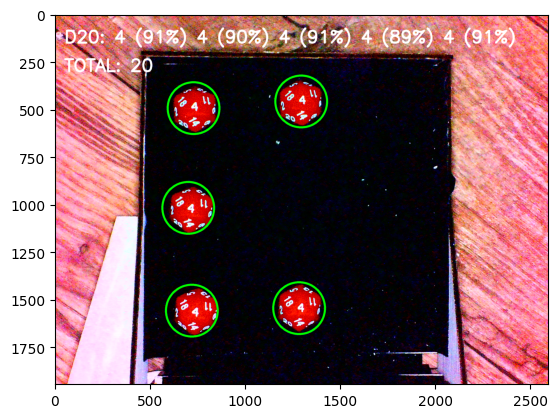

Finished search because best die match, 20, has low confidence: 18.411976%


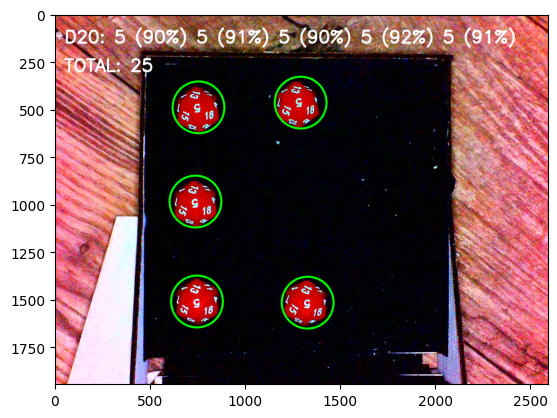

Finished search because best die match, 20, has low confidence: 20.669979%


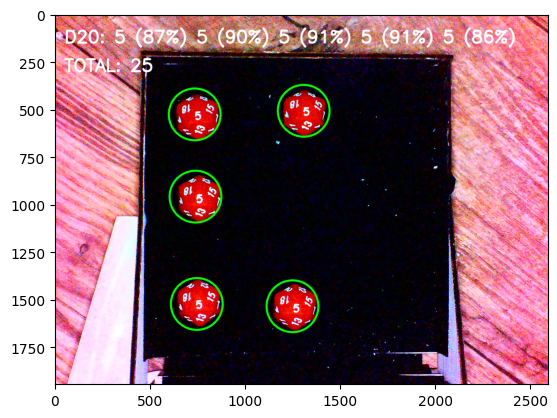

Finished search because best die match, 20, has low confidence: 17.308956%


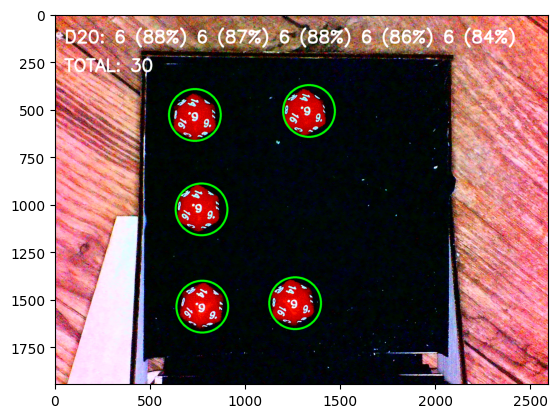

Finished search because best die match, 20, has low confidence: 11.733246%


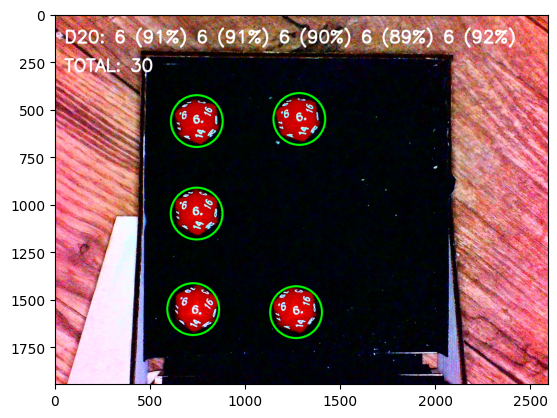

Finished search because best die match, 20, has low confidence: 17.114055%


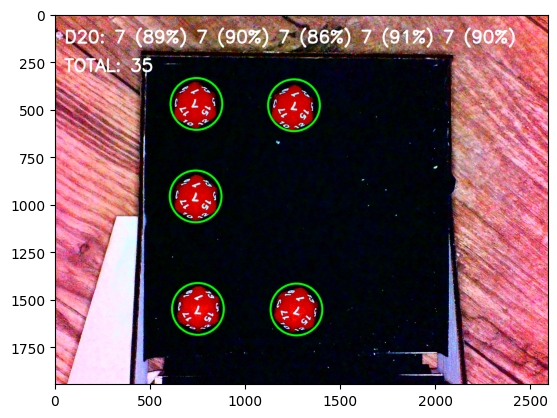

Finished search because best die match, 20, has low confidence: 18.624204%


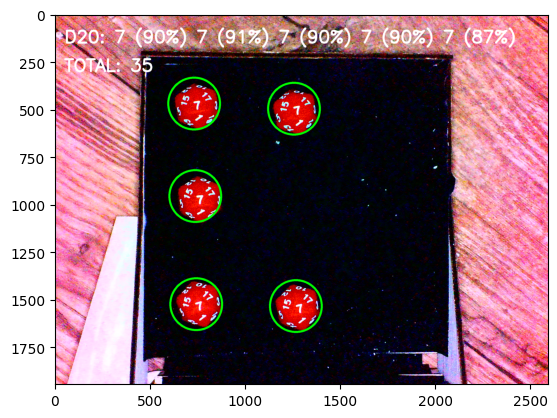

Finished search because best die match, 20, has low confidence: 19.555414%


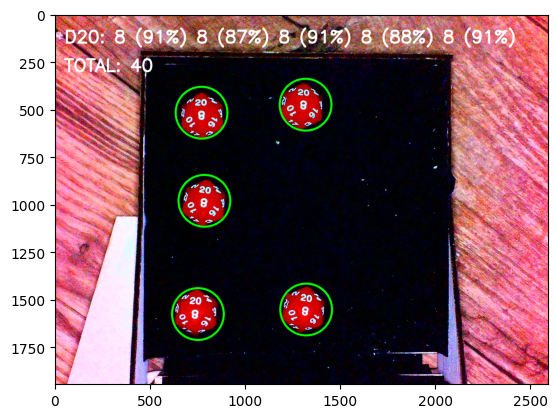

Finished search because best die match, 20, has low confidence: 19.174266%


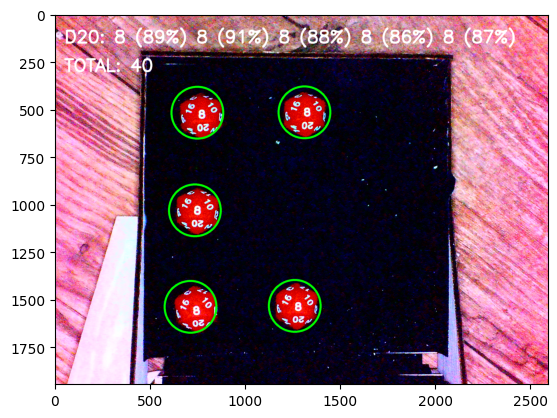

Finished search because best die match, 20, has low confidence: 15.824795%


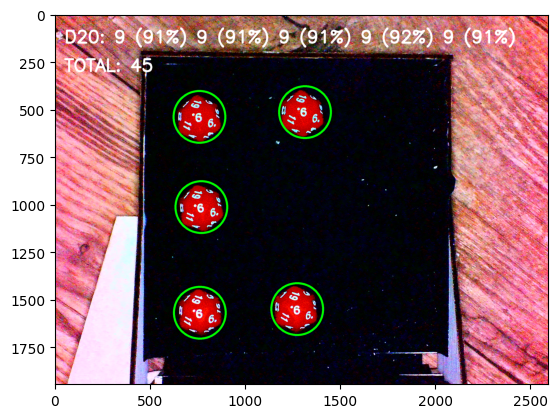

Finished search because best die match, 20, has low confidence: 23.632526%


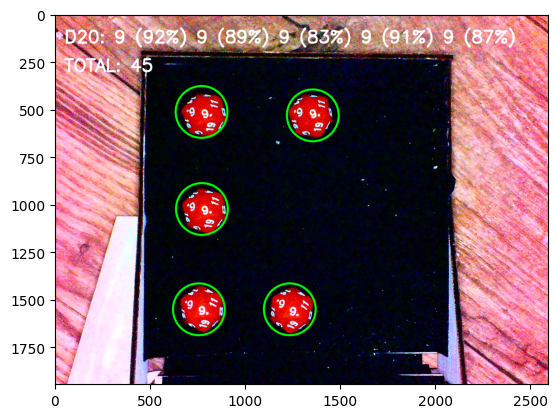

Finished search because best die match, 20, has low confidence: 13.036942%


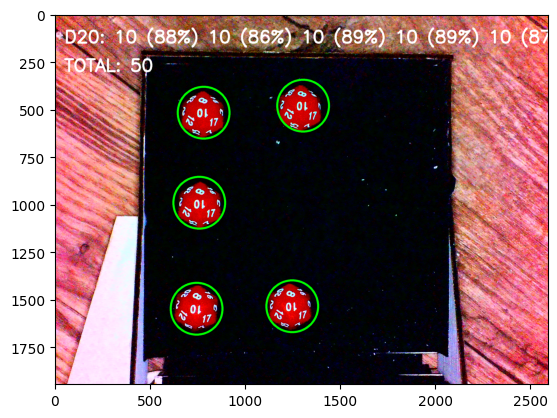

Finished search because best die match, 20, has low confidence: 21.953458%


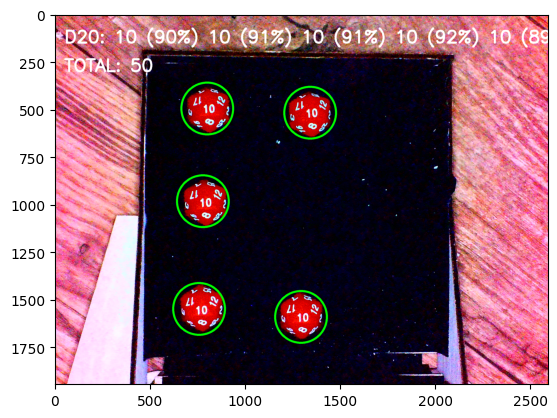

Finished search because best die match, 20, has low confidence: 23.434734%


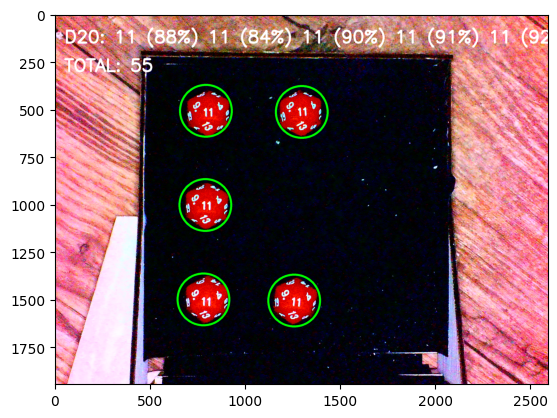

Finished search because best die match, 20, has low confidence: 19.907683%


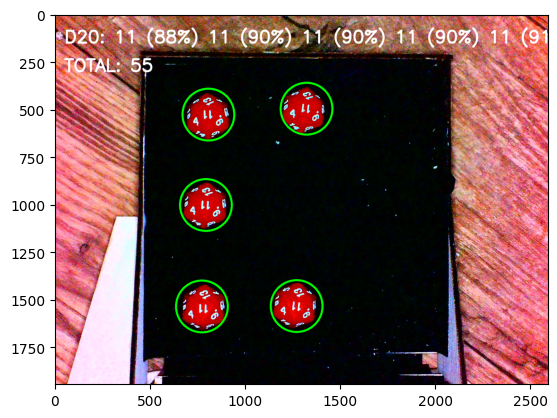

Finished search because best die match, 20, has low confidence: 18.976474%


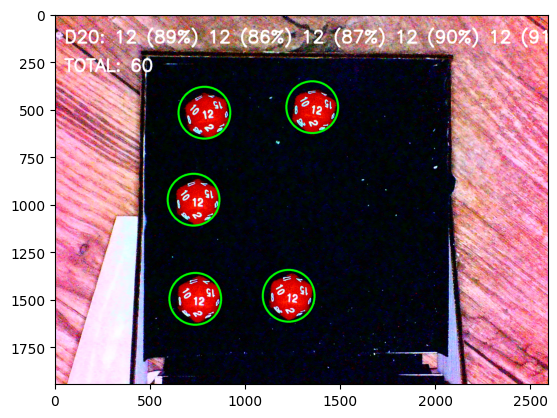

Finished search because best die match, 20, has low confidence: 15.824795%


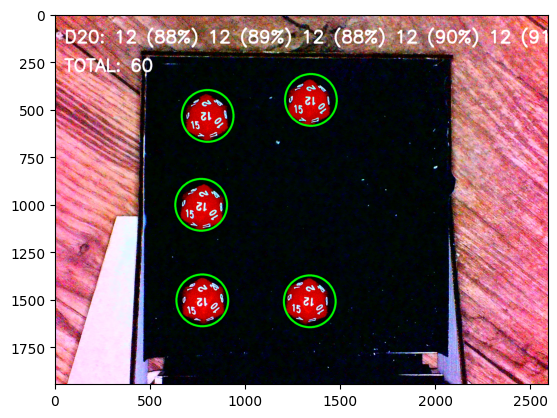

Finished search because best die match, 20, has low confidence: 22.517961%


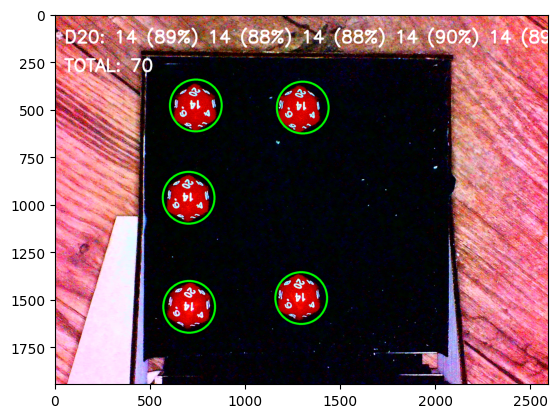

Finished search because best die match, 20, has low confidence: 15.068281%


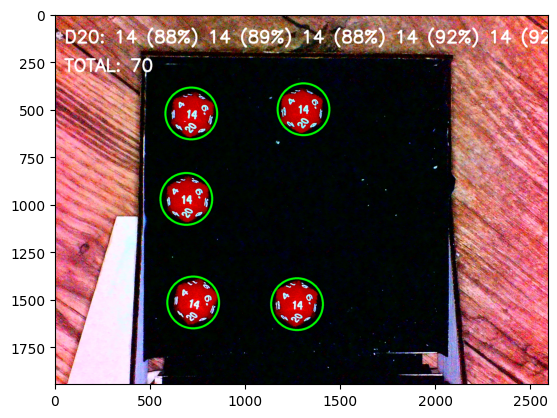

Finished search because best die match, 20, has low confidence: 17.692989%


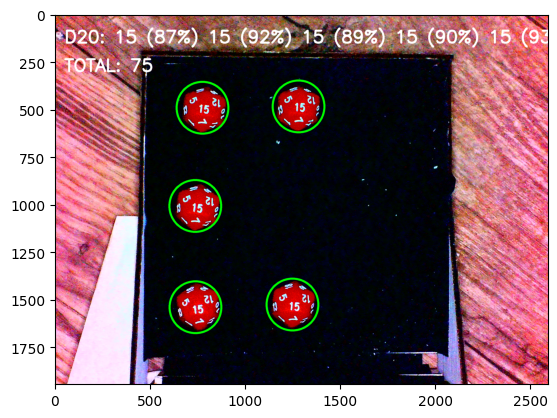

Finished search because best die match, 20, has low confidence: 13.205862%


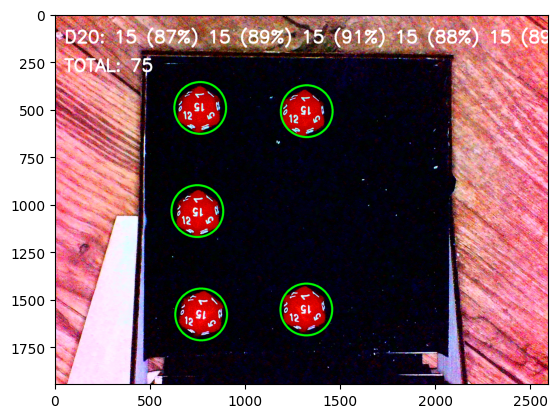

Finished search because best die match, 20, has low confidence: 11.352098%


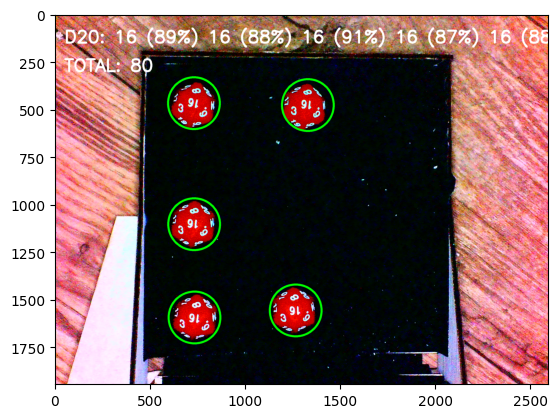

Finished search because best die match, 20, has low confidence: 14.701569%


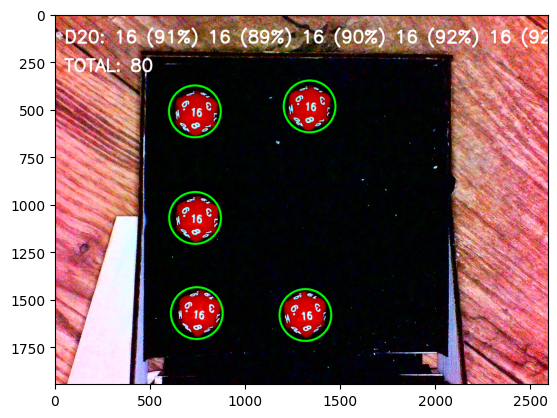

Finished search because best die match, 20, has low confidence: 16.761780%


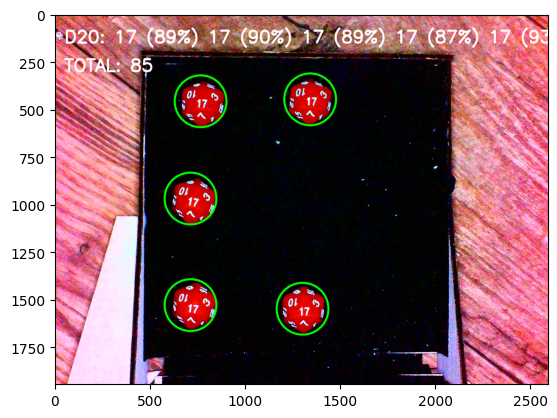

Finished search because best die match, 20, has low confidence: 18.624204%


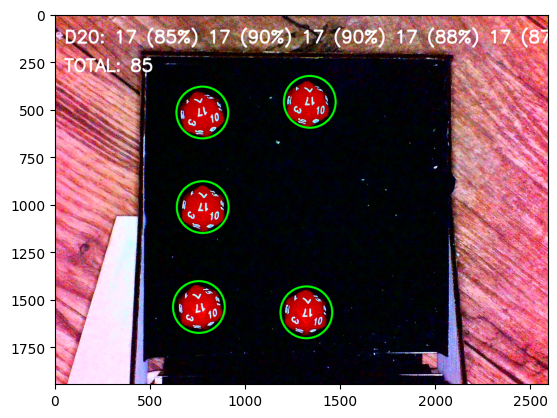

Finished search because best die match, 20, has low confidence: 16.366202%


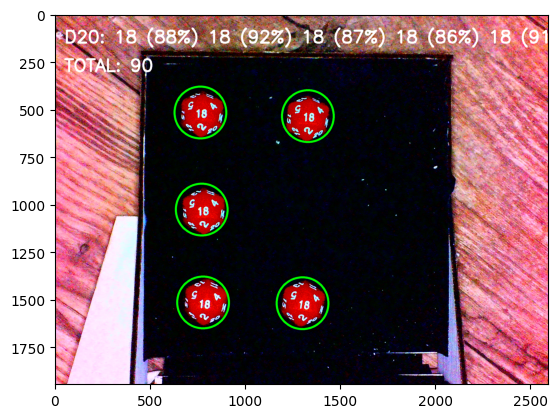

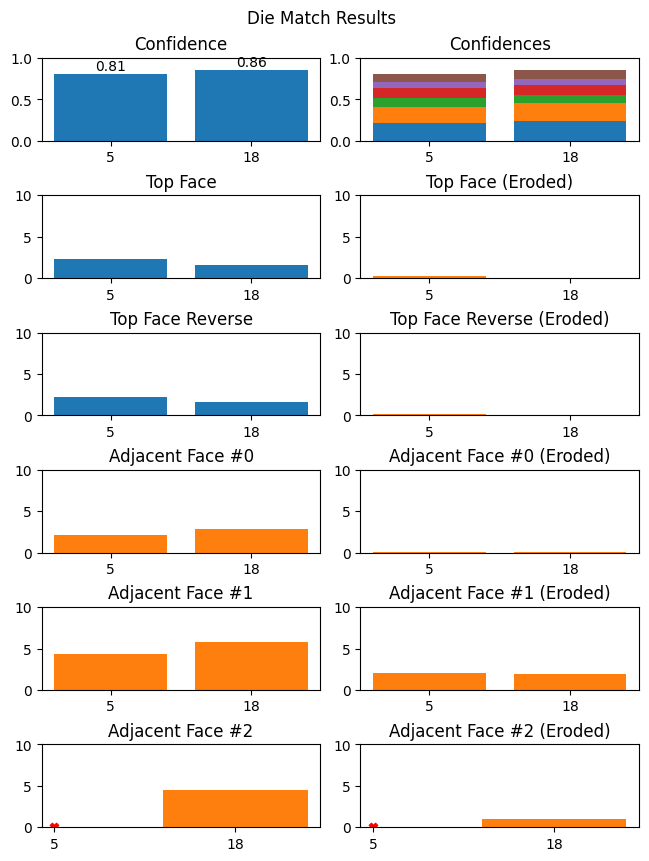

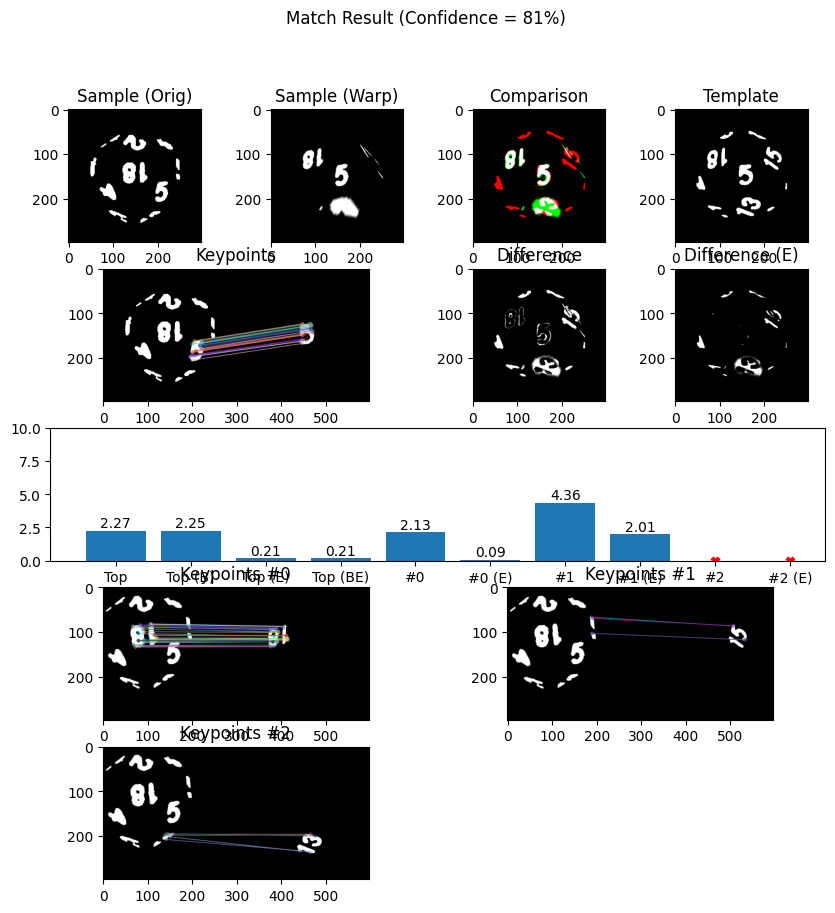

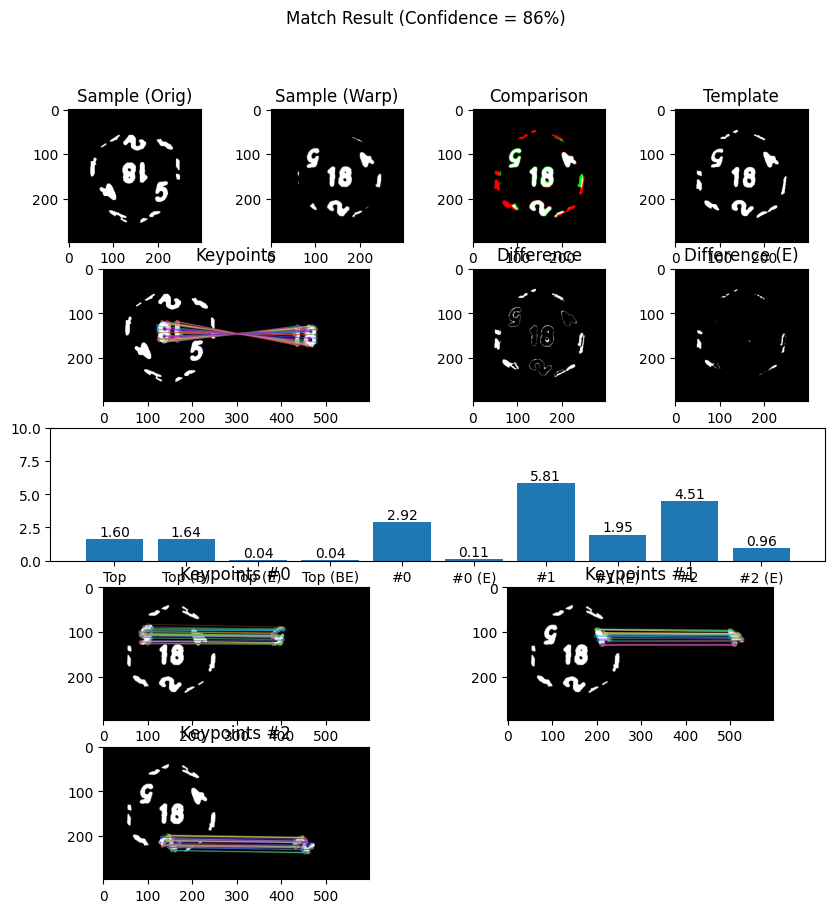

Finished search because best die match, 20, has low confidence: 17.297411%


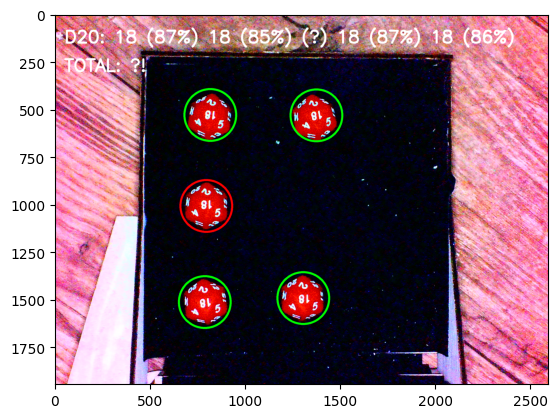

Finished search because best die match, 20, has low confidence: 19.343185%


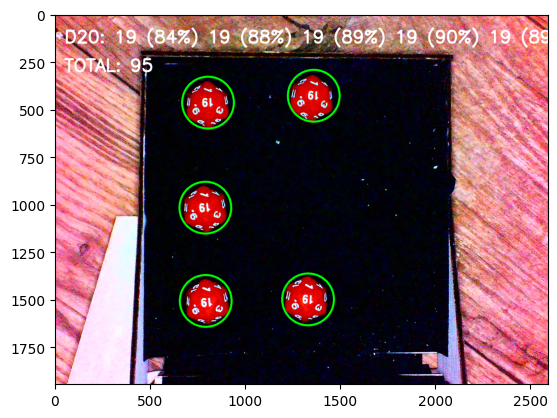

Finished search because best die match, 20, has low confidence: 19.555414%


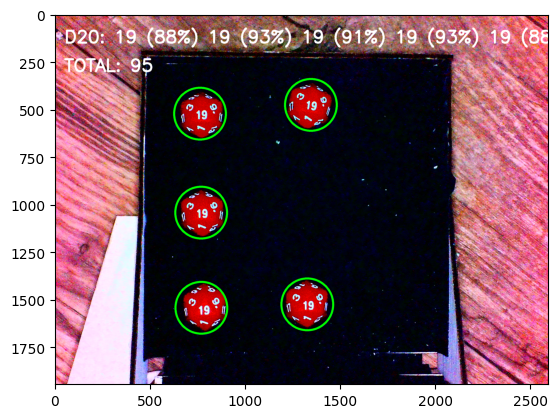

Finished search because best die match, 20, has low confidence: 15.443647%


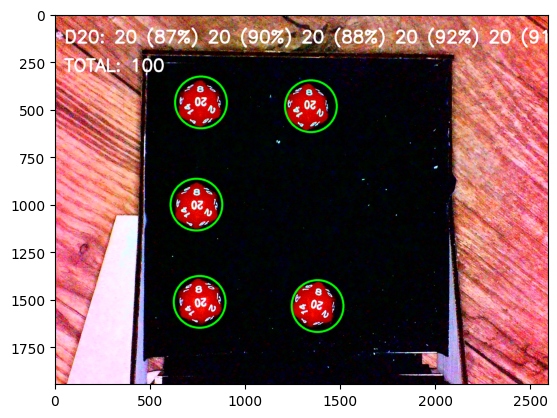

Finished search because best die match, 20, has low confidence: 8.183098%


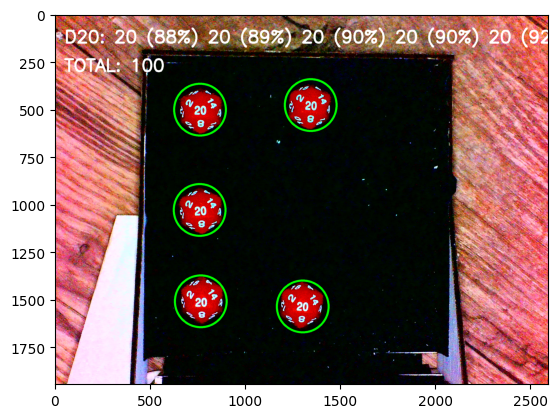

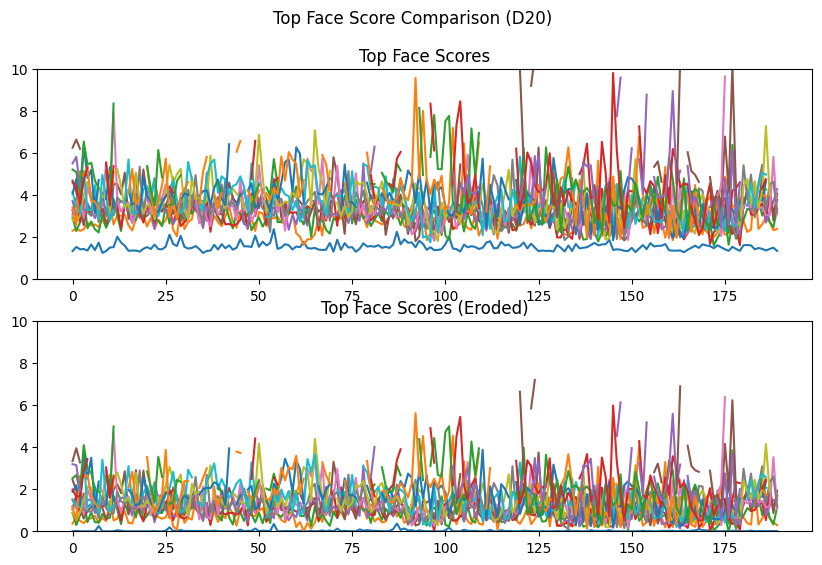

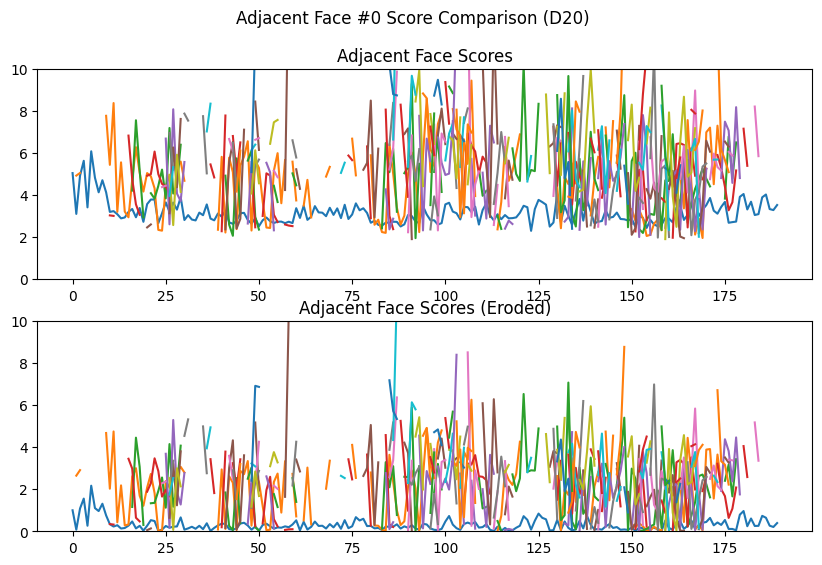

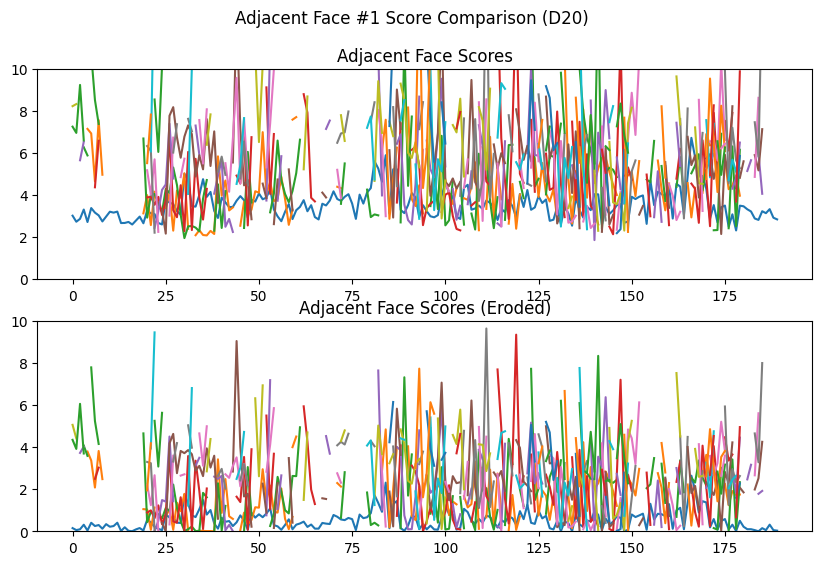

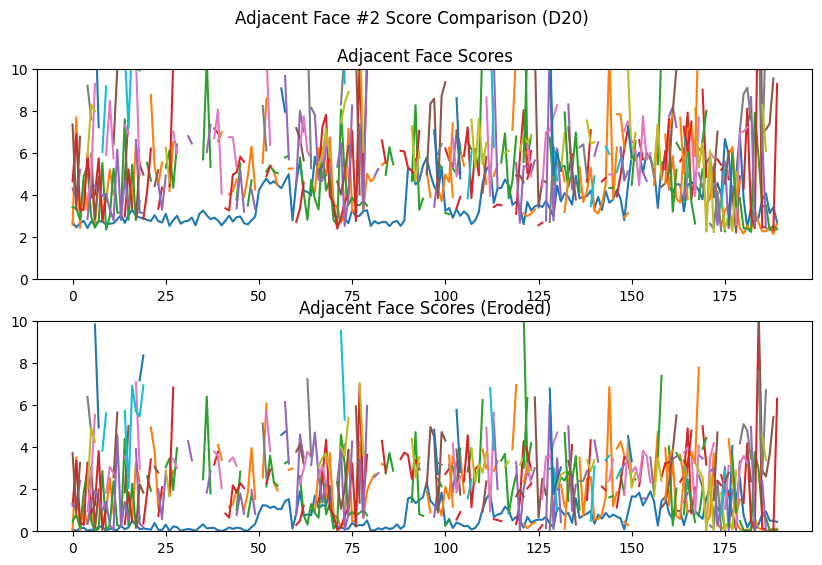

In [11]:

name = 20
all_matches_list = list()
for face in np.arange(0,21):
    sample_file_template = sample_template.replace("DR#",str(name))
    sample_file_template = sample_file_template.replace("FV#",str(face))
    sample_images_RGB = get_mactching_images_RGB(sample_file_template,log_level=LOG_LEVEL_INFO)
    die = dieset.dies[str(name)]
    for sample_image in sample_images_RGB:
        results = dieset.get_die_faces_from_image(sample_image,roi_mask=roi_mask,log_level=LOG_LEVEL_INFO)
        matches_list = [match_results[1] for die_results in results.values() for match_results in die_results]
        all_matches_list.extend(matches_list)
view_face_match_scores(all_matches_list, "D%u"%name)


In [ ]:
name = 6
roll_template = "Images\\Rolls\\stack dDR# (R#).jpg"
roll_template = roll_template.replace("DR#",str(name))
roll = 6
#for roll in np.arange(1,20):
roll_file = roll_template.replace("R#",str(roll))
image_roll_RGB = cv.cvtColor(cv.imread(roll_file),cv.COLOR_BGR2RGB)
die = dieset.dies[str(name)]
result = die.get_best_point_from_image(image_roll_RGB,roi_mask,log_level=LOG_LEVEL_INFO)
sample = die.get_sample_at_point_from_image(image_roll_RGB,result.point,log_level=LOG_LEVEL_DEBUG)
results = die.compare_to_sample(sample, log_level=LOG_LEVEL_INFO)
#die.view_match_results(results)
best_match = results[np.argmax([r.confidence for r in results])]
print(best_match.top_face_match.warp_offset)
print(best_match)

dieset.get_die_faces_from_image(image_roll_RGB,roi_mask=roi_mask,log_level=LOG_LEVEL_INFO)